<a href="https://colab.research.google.com/github/Kate-Strydom/cse450/blob/main/notebooks/starter_housing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Packages to Install

In [67]:
#!pip install pygeohash

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Created wheel for pygeohash: filename=pygeohash-1.2.0-py2.py3-none-any.whl size=6167 sha256=c6e12978b7480fd0c5f74bb4b39e86923194c34a80a657a8b95b3551a6727e90
  Stored in directory: /root/.cache/pip/wheels/e2/ed/86/be7141d743cfb4aebac76406187154cd78fe9e6535d872187a
Successfully built pygeohash


# Imports

In [68]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plts
import altair as alt
import pygeohash as gh

alt.data_transformers.disable_max_rows()


DataTransformerRegistry.enable('default')

In [13]:
# use set option
#changes behaviour globally.
pd.set_option('display.float_format', lambda x: '%.5f' % x)

# Data Preprocessing

In [91]:
housing = pd.read_csv('https://raw.githubusercontent.com/byui-cse/cse450-course/master/data/housing.csv')
house = pd.read_csv('https://raw.githubusercontent.com/byui-cse/cse450-course/master/data/housing.csv')
target = house.pop("price")
zipcode = pd.read_csv('https://raw.githubusercontent.com/carlosdgerez/machine_learning/main/mean_income_washington_by_zipcode.csv')

In [92]:
zipcode.head()

,zip_code,mean_income
0,98001,102586
1,98002,70945
2,98003,76753
3,98004,210129
4,98005,186020


In [98]:
# merge zip data 
left_merged = pd.merge(housing, zipcode, how="left", on=["zip_code", "mean_income"])

KeyError: ignored

In [88]:
housing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             20000 non-null  int64  
 1   date           20000 non-null  object 
 2   bedrooms       20000 non-null  int64  
 3   bathrooms      20000 non-null  float64
 4   sqft_living    20000 non-null  int64  
 5   sqft_lot       20000 non-null  int64  
 6   floors         20000 non-null  float64
 7   waterfront     20000 non-null  int64  
 8   view           20000 non-null  int64  
 9   condition      20000 non-null  int64  
 10  grade          20000 non-null  int64  
 11  sqft_above     20000 non-null  int64  
 12  sqft_basement  20000 non-null  int64  
 13  yr_built       20000 non-null  int64  
 14  yr_renovated   20000 non-null  int64  
 15  zipcode        20000 non-null  int64  
 16  lat            20000 non-null  float64
 17  long           20000 non-null  float64
 18  sqft_l

In [90]:
zipcode.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 598 entries, 0 to 597
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype
---  ------       --------------  -----
 0   zip_code     598 non-null    int64
 1   mean_income  598 non-null    int64
dtypes: int64(2)
memory usage: 9.5 KB


In [87]:
housing.head()

,id,date,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,1565930130,20141104T000000,4,3.25000,3760,4675,2.00000,0,0,3,8,2740,1020,2007,0,98038,47.38620,-122.04800,3280,4033
1,3279000420,20150115T000000,3,1.75000,1460,7800,1.00000,0,0,2,7,1040,420,1979,0,98023,47.30350,-122.38200,1310,7865
2,194000575,20141014T000000,4,1.00000,1340,5800,1.50000,0,2,3,7,1340,0,1914,0,98116,47.56580,-122.38900,1900,5800
3,2115510160,20141208T000000,3,1.75000,1440,8050,1.00000,0,0,3,8,1440,0,1985,0,98023,47.31870,-122.39000,1790,7488
4,7522500005,20140815T000000,2,1.50000,1780,4750,1.00000,0,0,4,7,1080,700,1947,0,98117,47.68590,-122.39500,1690,5962


## Understanding the data

### How should longitude and latitude be used in an estimation model?
https://datascience.stackexchange.com/questions/23651/can-gps-coordinates-latitude-and-longitude-be-used-as-features-in-a-linear-mod


In [72]:
# create a geo_hash for longitude and latitude

housing['geohash']=housing.apply(lambda x: gh.encode(x.lat, x.long, precision=5), axis=1)
housing.head()

,id,date,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,price,geohash
0,1565930130,20141104T000000,4,3.25000,3760,4675,2.00000,0,0,3,...,1020,2007,0,98038,47.38620,-122.04800,3280,4033,429900.00000,c23jw
1,3279000420,20150115T000000,3,1.75000,1460,7800,1.00000,0,0,2,...,420,1979,0,98023,47.30350,-122.38200,1310,7865,233000.00000,c22vp
2,194000575,20141014T000000,4,1.00000,1340,5800,1.50000,0,2,3,...,0,1914,0,98116,47.56580,-122.38900,1900,5800,455000.00000,c22yw
3,2115510160,20141208T000000,3,1.75000,1440,8050,1.00000,0,0,3,...,0,1985,0,98023,47.31870,-122.39000,1790,7488,258950.00000,c22vn
4,7522500005,20140815T000000,2,1.50000,1780,4750,1.00000,0,0,4,...,700,1947,0,98117,47.68590,-122.39500,1690,5962,555000.00000,c22zq


In [82]:
housing['geo_hash'] = housing.apply(lambda x: gh.decode(x.geohash), axis= 1)
housing.head()

,id,date,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,price,geohash,geo_hash
0,1565930130,20141104T000000,4,3.25000,3760,4675,2.00000,0,0,3,...,2007,0,98038,47.38620,-122.04800,3280,4033,429900.00000,c23jw,"(47.4, -122.1)"
1,3279000420,20150115T000000,3,1.75000,1460,7800,1.00000,0,0,2,...,1979,0,98023,47.30350,-122.38200,1310,7865,233000.00000,c22vp,"(47.3, -122.4)"
2,194000575,20141014T000000,4,1.00000,1340,5800,1.50000,0,2,3,...,1914,0,98116,47.56580,-122.38900,1900,5800,455000.00000,c22yw,"(47.6, -122.4)"
3,2115510160,20141208T000000,3,1.75000,1440,8050,1.00000,0,0,3,...,1985,0,98023,47.31870,-122.39000,1790,7488,258950.00000,c22vn,"(47.3, -122.4)"
4,7522500005,20140815T000000,2,1.50000,1780,4750,1.00000,0,0,4,...,1947,0,98117,47.68590,-122.39500,1690,5962,555000.00000,c22zq,"(47.7, -122.4)"


In [81]:
housing.describe()

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,price
count,20000.00000,20000.00000,20000.00000,20000.00000,20000.00000,20000.00000,20000.00000,20000.00000,20000.00000,20000.00000,20000.00000,20000.00000,20000.00000,20000.00000,20000.00000,20000.00000,20000.00000,20000.00000,20000.00000,20000.00000
mean,4580297056.71370,3.37020,2.11575,2079.88310,15015.32895,1.49645,0.00755,0.23490,3.40970,7.65770,1790.23290,289.65020,1971.10015,82.73215,98077.87685,47.55997,-122.21390,1986.38750,12748.96040,539436.71295
std,2875294849.88799,0.93193,0.77013,919.43367,39701.34754,0.54095,0.08656,0.76769,0.65190,1.17529,829.58710,441.53707,29.37401,397.87234,53.43803,0.13852,0.14065,685.21151,27076.48904,366433.43612
min,1000102.00000,0.00000,0.00000,290.00000,520.00000,1.00000,0.00000,0.00000,1.00000,1.00000,290.00000,0.00000,1900.00000,0.00000,98001.00000,47.15590,-122.51900,399.00000,651.00000,75000.00000
25%,2123049478.50000,3.00000,1.75000,1430.00000,5040.00000,1.00000,0.00000,0.00000,3.00000,7.00000,1200.00000,0.00000,1951.75000,0.00000,98033.00000,47.47067,-122.32800,1490.00000,5100.00000,322000.00000
50%,3904955440.00000,3.00000,2.25000,1910.00000,7620.00000,1.50000,0.00000,0.00000,3.00000,7.00000,1560.00000,0.00000,1975.00000,0.00000,98065.00000,47.57145,-122.23000,1840.00000,7622.00000,450000.00000
75%,7309825262.50000,4.00000,2.50000,2550.00000,10710.00000,2.00000,0.00000,0.00000,4.00000,8.00000,2210.00000,560.00000,1997.00000,0.00000,98117.00000,47.67800,-122.12400,2360.00000,10088.25000,641625.00000
max,9900000190.00000,33.00000,8.00000,13540.00000,1164794.00000,3.50000,1.00000,4.00000,5.00000,13.00000,9410.00000,4820.00000,2015.00000,2015.00000,98199.00000,47.77760,-121.31500,6210.00000,871200.00000,7700000.00000


Outlier in bedrooms & sqft_living needs to be removed.




# insert box whisker plot.


In [83]:
house = housing[(housing['bedrooms'] < 33) & (housing['sqft_living'] < 10000) & (housing['sqft_lot'] < 500000) & (housing['sqft_basement'] < 2000 ) & (housing['price'] < 5000000)]
print(house.describe())

                    id    bedrooms   bathrooms  sqft_living     sqft_lot  \
count      19906.00000 19906.00000 19906.00000  19906.00000  19906.00000   
mean  4582189170.12192     3.36341     2.10828   2065.12338  14262.94645   
std   2875357637.83136     0.90229     0.75788    884.12368  32010.88430   
min      1000102.00000     0.00000     0.00000    290.00000    520.00000   
25%   2123212130.25000     3.00000     1.50000   1420.00000   5027.00000   
50%   3904980150.00000     3.00000     2.25000   1910.00000   7600.00000   
75%   7312075067.50000     4.00000     2.50000   2540.00000  10620.75000   
max   9900000190.00000    11.00000     7.50000   8020.00000 499571.00000   

           floors  waterfront        view   condition       grade  sqft_above  \
count 19906.00000 19906.00000 19906.00000 19906.00000 19906.00000 19906.00000   
mean      1.49681     0.00718     0.22852     3.40912     7.64684  1783.20798   
std       0.54101     0.08445     0.75550     0.65148     1.16158   817.

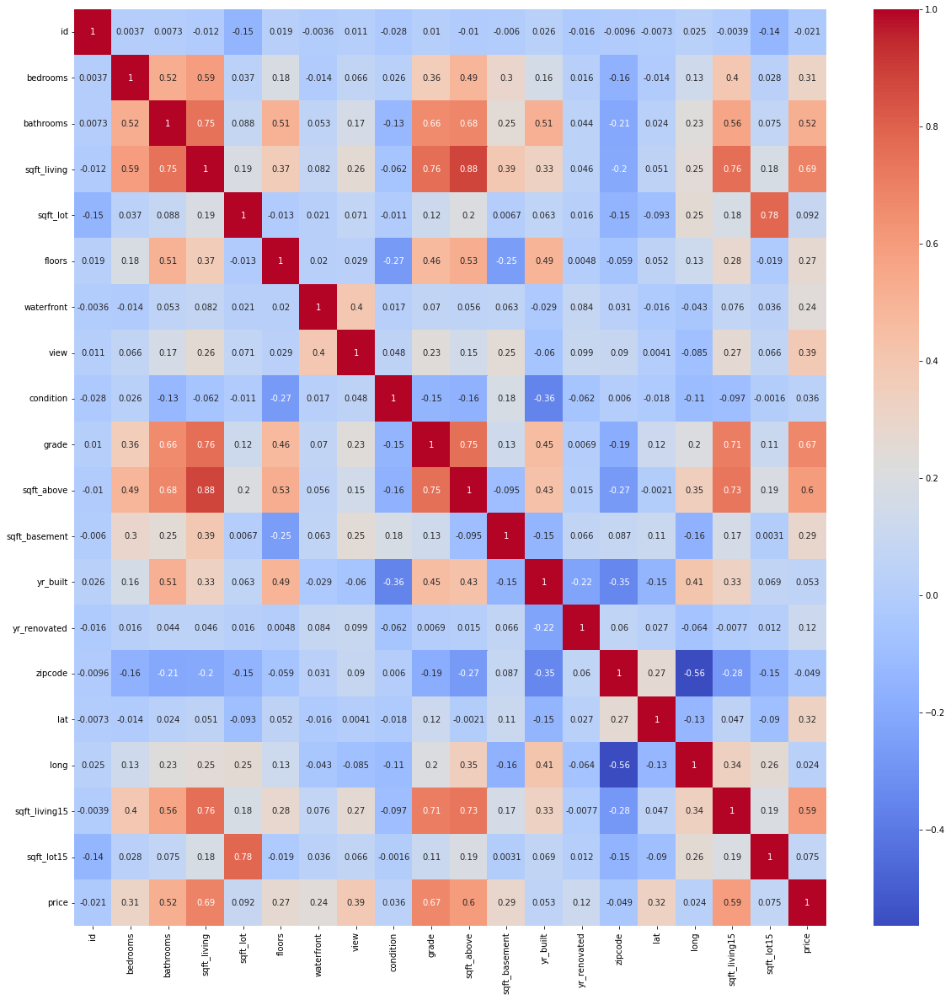

In [61]:
#Correlation of numeric data 
corr = house.corr()

#plot corrrelation heat map
plt.figure(figsize=(20,20))
sns.heatmap(house.corr(),annot=True,cmap="coolwarm")

In [56]:
alt.Chart(house).mark_boxplot(extent='min-max').encode(
    x='bedrooms:Q',
    y='price:Q'
).properties(height = 600, width = 600)

alt.Chart(...)

In [58]:
alt.Chart(house).mark_point().encode(
    x='sqft_living:Q',
    y='price:Q'
).properties(height = 600, width = 600)

alt.Chart(...)

In [55]:
alt.Chart(house).mark_boxplot(extent='min-max').encode(
    x='bathrooms:Q',
    y='price:Q'
).properties(height = 600, width = 600)

alt.Chart(...)

In [ ]:
zip_code = pd.read_csv(r"C:\Users\kate\Downloads\ACSST5Y2020.S1901_2022-05-23T173128\zip_data.csv")

In [ ]:
# Importing required modules
import numpy as np
import pandas as pd
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.preprocessing import LabelEncoder 
# Let us create the Data-Frame for above 
X=pd.DataFrame({'LikesExercising':[False,False,False,True,False,True,True,True,True],
                'GotoGym':[True,True,True,True,True,False,True,False,False],
                 'DrivesCar':[True,False,False,True,True,False,True,False,True]})
Y=pd.Series(name='Age',data=[14,15,16,26,36,50,69,72,74])
# Let us encode true and false to number value 0 and 1
LE=LabelEncoder()
X['LikesExercising']=LE.fit_transform(X['LikesExercising'])
X['GotoGym']=LE.fit_transform(X['GotoGym'])
X['DrivesCar']=LE.fit_transform(X['DrivesCar'])

In [ ]:
#We will now see the effect of different numbers of estimators on MSE.
# 1) Let us now use  GradientBoostingRegressor with 2 estimators to train the model and to predict the age for the same inputs. 
GB=GradientBoostingRegressor(n_estimators=2)
GB.fit(X,Y)
Y_predict=GB.predict(X) #ages predicted by model with 2 estimators 
Y_predict
# Output
#Y_predict=[38.23 , 36.425, 36.425, 42.505, 38.23 , 45.07 , 42.505, 45.07 ,47.54]
#Following code is used to find out MSE of prediction with Gradient boosting algorithm having estimator 2.
MSE_2=(sum((Y-Y_predict)**2))/len(Y)
print('MSE for two estimators :',MSE_2)
#Output: MSE for two estimators : 432.482055555546

In [ ]:
housing.info()